Text Extraction
From the following link, extract the text (title and abstract) of each scientific article, then save it in a text file named 𝐃 < 𝒊 >. 𝐭𝐱𝐭, where 1 ≤ 𝑖 ≤ 𝐍, with 𝐍 being
the number of scientific articles.
https://link.springer.com/journal/12065/volumes-and-issues/18-5
Text Preprocessing
- Create a file T.txt containing all the tokens of the extracted scientific articles, using the Regex function from NLTK.
- Create a file T_N.txt containing all the normalized tokens of the extracted scientific articles, using the Snowball stemming function from NLTK. Tokens must
be converted to lowercase first.
- Create a file V.txt containing the vocabulary (set of unique words) of all the extracted scientific articles, using the Regex function from NLTK.
- Create a file V_N.txt containing the vocabulary (set of unique normalized words) of all the extracted scientific articles, using the Regex function from NLTK.
- Create a file S.txt containing all the sentences of the extracted scientific articles, using the Regex function from NLTK.
Data Visualization
Using the WordCloud library, visualize the content of the files T.txt and T_N.txt.
Edit Distance
Implement the algorithm that computes the minimum edit distance (or Levenshtein distance) between two strings, as covered in class.

# Importing Libraries 

In [2]:
import nltk
import pandas as pd
from bs4 import BeautifulSoup
import requests


# Extracting the title and abstract 

In [ ]:
# import requests
# from bs4 import BeautifulSoup
# import time
# import os

# def extract_all_articles():
#     # Create directory if it doesn't exist
#     os.makedirs('D', exist_ok=True)
    
#     html_text = requests.get('https://link.springer.com/journal/12065/volumes-and-issues/18-5').text
    
#     # CHANGED: Replace 'lxml' with 'html.parser'
#     soup = BeautifulSoup(html_text, 'html.parser')

#     # Find all article links (adjust selector as needed)
#     links = soup.find_all('a', href=lambda x: x and x.startswith('/article/'))
#     i=0
#     for link in links:
#         i= i+1
#         href = link.get('href')
#         title = link.get_text(strip=True)

#         # retriving the abstract
#         article_url = f'https://link.springer.com{href}'
#         article_html = requests.get(article_url).text
#         article_soup = BeautifulSoup(article_html, 'html.parser')  # CHANGED: html.parser

#         # Using the specific class 
#         abstract_div = article_soup.find('div', {'class': 'c-article-section__content'})
#         if abstract_div:
#             abstract = abstract_div.find('p').get_text(strip=True)
#         else:
#             abstract = "Abstract not found"

#         # saving title and abstract to a text file in folder D
#         with open(f'D/D{i}.txt', 'w', encoding='utf-8') as f:
#             f.write(f'{title}\n\n')
#             f.write(f'{abstract}\n')
        
#         # Add delay
#         time.sleep(2)

# if __name__ == '__main__':
#     # Remove infinite loop or add delay
#     extract_all_articles()

# tokens of the extracted scientific articles, using the Regex function from NLTK.

In [ ]:
import os
import glob
import nltk
from nltk.tokenize import RegexpTokenizer

# Download NLTK data if not already installed
nltk.download('punkt', quiet=True)

def simple_token_extraction():
    """Extract tokens from D/*.txt using NLTK RegexTokenizer and write directly to T.txt"""
    output_file = 'T.txt'
    tokenizer = RegexpTokenizer(r'\b[a-zA-Z]+\b')

    
    all_tokens = []
    
    # Process all files in D directory
    for d_file in sorted(glob.glob('D/*.txt')):
        try:
            with open(d_file, 'r', encoding='utf-8') as f:
                content = f.read()
            
            # Tokenize using NLTK regex
            tokens = tokenizer.tokenize(content)
            all_tokens.extend(tokens)
            
            print(f"Extracted {len(tokens)} tokens from {d_file}")
        
        except Exception as e:
            print(f"Error processing {d_file}: {e}")
    
    # Write all tokens to T.txt
    with open(output_file, 'w', encoding='utf-8') as f:
        f.write('\n'.join(all_tokens))
    
    print(f"\n✅ Created {output_file} with {len(all_tokens)} total tokens from {len(glob.glob('D/*.txt'))} files.")

if __name__ == '__main__':
    simple_token_extraction()


In [7]:
# combining all tokens of T files into a T.txt file
def combine_T_files():
    """Combine all T_*.txt files into a single T.txt file."""
    output_file = 'T.txt'
    all_tokens = []
    
    # Process each T_*.txt file
    for t_file in sorted(glob.glob('T_/T_*.txt')):
        try:
            with open(t_file, 'r', encoding='utf-8') as f:
                tokens = f.read().splitlines()
                all_tokens.extend(tokens)
            
            print(f"Read {len(tokens)} tokens from {t_file}")
        
        except Exception as e:
            print(f"Error processing {t_file}: {e}")
    
    # Write all tokens to T.txt
    with open(output_file, 'w', encoding='utf-8') as f:
        f.write('\n'.join(all_tokens))
    
    print(f"\n✅ Created {output_file} with {len(all_tokens)} total tokens from {len(glob.glob('T_/T_*.txt'))} files.")

if __name__ == '__main__':
    combine_T_files()

Read 145 tokens from T_\T_1.txt
Read 640 tokens from T_\T_10.txt
Read 673 tokens from T_\T_11.txt
Read 696 tokens from T_\T_12.txt
Read 719 tokens from T_\T_13.txt
Read 788 tokens from T_\T_14.txt
Read 808 tokens from T_\T_15.txt
Read 830 tokens from T_\T_16.txt
Read 866 tokens from T_\T_17.txt
Read 908 tokens from T_\T_18.txt
Read 949 tokens from T_\T_19.txt
Read 256 tokens from T_\T_2.txt
Read 979 tokens from T_\T_20.txt
Read 1001 tokens from T_\T_21.txt
Read 310 tokens from T_\T_3.txt
Read 362 tokens from T_\T_4.txt
Read 400 tokens from T_\T_5.txt
Read 456 tokens from T_\T_6.txt
Read 501 tokens from T_\T_7.txt
Read 547 tokens from T_\T_8.txt
Read 587 tokens from T_\T_9.txt

✅ Created T.txt with 13421 total tokens from 21 files.


## T_N.txt containing all the normalized tokens of the extracted scientific articles, using the Snowball stemming function from NLTK. Tokens must be converted to lowercase first.

In [ ]:
from nltk.stem import SnowballStemmer

# Download required NLTK data
nltk.download('punkt', quiet=True)

def create_normalized_tokens_file():
    """
    Simple version to create T_N.txt with normalized tokens
    """
    stemmer = SnowballStemmer("english")
    all_tokens = []
    
    i=0
    # Process all D files
    t_file = 'T.txt'
    with open(t_file, 'r', encoding='utf-8') as f:
        content = f.read()
      
    # Normalize: lowercase + stemming
    for word in content.split():
        normalized = stemmer.stem(word.lower())
        if len(normalized) > 2:  # Filter short stems
            all_tokens.append(normalized)
    
    # Remove duplicates and sort
    unique_tokens = sorted(set(all_tokens))
    
    # Save to T_N.txt
    with open(f'T_/T_{i}.txt', 'w', encoding='utf-8') as f:
        f.write('\n'.join(unique_tokens))
    
    print(f"Created T_{i}.txt with {len(unique_tokens)} unique normalized tokens")

if __name__ == '__main__':
    create_normalized_tokens_file()

## - Create a file V_N.txt containing the vocabulary (set of unique normalized words) of all the extracted scientific articles, using the Regex function from NLTK.


In [4]:
import os
import glob
import nltk
from nltk.tokenize import RegexpTokenizer

# Download NLTK resources if not already available
nltk.download('punkt', quiet=True)

def create_individual_vocabularies():
    """
    For each T_/T_i.txt file, create a V_/V_i.txt file
    containing its unique normalized words using NLTK's RegexTokenizer.
    """
    os.makedirs('V_', exist_ok=True)  # ensure output directory exists
    tokenizer = RegexpTokenizer(r'\b[a-zA-Z]{2,}\b')  # 2+ letters only

    # Process each normalized token file
    for i, t_file in enumerate(sorted(glob.glob('T_/T_*.txt')), start=1):
        with open(t_file, 'r', encoding='utf-8') as f:
            content = f.read()

        # Tokenize using NLTK regex
        tokens = tokenizer.tokenize(content)

        # Build unique vocabulary for this file
        vocab = sorted(set(tokens))

        # Save to corresponding V_i.txt
        v_file = f'V_/V_{i}.txt'
        with open(v_file, 'w', encoding='utf-8') as f:
            f.write('\n'.join(vocab))

        print(f"✅ Created {v_file} with {len(vocab)} unique tokens from {t_file}")

if __name__ == '__main__':
    create_individual_vocabularies()


✅ Created V_/V_1.txt with 145 unique tokens from T_\T_1.txt
✅ Created V_/V_2.txt with 640 unique tokens from T_\T_10.txt
✅ Created V_/V_3.txt with 673 unique tokens from T_\T_11.txt
✅ Created V_/V_4.txt with 696 unique tokens from T_\T_12.txt
✅ Created V_/V_5.txt with 719 unique tokens from T_\T_13.txt
✅ Created V_/V_6.txt with 788 unique tokens from T_\T_14.txt
✅ Created V_/V_7.txt with 808 unique tokens from T_\T_15.txt
✅ Created V_/V_8.txt with 830 unique tokens from T_\T_16.txt
✅ Created V_/V_9.txt with 866 unique tokens from T_\T_17.txt
✅ Created V_/V_10.txt with 908 unique tokens from T_\T_18.txt
✅ Created V_/V_11.txt with 949 unique tokens from T_\T_19.txt
✅ Created V_/V_12.txt with 256 unique tokens from T_\T_2.txt
✅ Created V_/V_13.txt with 979 unique tokens from T_\T_20.txt
✅ Created V_/V_14.txt with 1001 unique tokens from T_\T_21.txt
✅ Created V_/V_15.txt with 310 unique tokens from T_\T_3.txt
✅ Created V_/V_16.txt with 362 unique tokens from T_\T_4.txt
✅ Created V_/V_17.tx

## - Create a file S.txt containing all the sentences of the extracted scientific articles, using the Regex function from NLTK.


In [10]:
# accessing the D files from D folder to extract the abstract only
# retrieve the sentences from the abstract and saving them into a text file S.txt
import os
import glob
import nltk
from nltk.tokenize import sent_tokenize

# Download NLTK resources (for sentence tokenization)
nltk.download('punkt', quiet=True)
nltk.download('punkt_tab', quiet=True)

def extract_abstract_sentences():
    """
    Extract the abstract (everything after the first line) from each D file,
    split it into sentences, and save all sentences into S.txt.
    """
    output_file = 'S.txt'
    all_sentences = []

    # Process all files in the D folder
    for d_file in sorted(glob.glob('D/*.txt')):
        with open(d_file, 'r', encoding='utf-8') as f:
            lines = f.readlines()

        # Skip title (usually the first non-empty line)
        # Find where the abstract starts (after a blank line)
        abstract_lines = []
        found_blank = False
        for line in lines:
            if line.strip() == "":
                found_blank = True
                continue
            if found_blank:  # start collecting lines after the blank line
                abstract_lines.append(line.strip())

        abstract_text = " ".join(abstract_lines)

        # Split abstract into sentences using NLTK
        sentences = sent_tokenize(abstract_text)

        # Add to global list
        all_sentences.extend(sentences)

        print(f"Processed {d_file}: extracted {len(sentences)} sentences.")

    # Write all sentences to S.txt
    with open(output_file, 'w', encoding='utf-8') as f:
        for sentence in all_sentences:
            f.write(sentence.strip() + '\n')

    print(f"\n✅ Created {output_file} with {len(all_sentences)} total sentences from {len(glob.glob('D/*.txt'))} abstracts.")

if __name__ == '__main__':
    extract_abstract_sentences()

Processed D\D1.txt: extracted 9 sentences.
Processed D\D10.txt: extracted 7 sentences.
Processed D\D11.txt: extracted 6 sentences.
Processed D\D12.txt: extracted 10 sentences.
Processed D\D13.txt: extracted 10 sentences.
Processed D\D14.txt: extracted 13 sentences.
Processed D\D15.txt: extracted 12 sentences.
Processed D\D16.txt: extracted 7 sentences.
Processed D\D17.txt: extracted 6 sentences.
Processed D\D18.txt: extracted 13 sentences.
Processed D\D19.txt: extracted 8 sentences.
Processed D\D2.txt: extracted 8 sentences.
Processed D\D20.txt: extracted 8 sentences.
Processed D\D21.txt: extracted 10 sentences.
Processed D\D3.txt: extracted 8 sentences.
Processed D\D4.txt: extracted 8 sentences.
Processed D\D5.txt: extracted 8 sentences.
Processed D\D6.txt: extracted 10 sentences.
Processed D\D7.txt: extracted 10 sentences.
Processed D\D8.txt: extracted 10 sentences.
Processed D\D9.txt: extracted 15 sentences.

✅ Created S.txt with 196 total sentences from 21 abstracts.


## Data Visualization
Using the WordCloud library, visualize the content of the files T.txt and T_N.txt.


✅ Saved WordCloud image: WordClouds\T.png


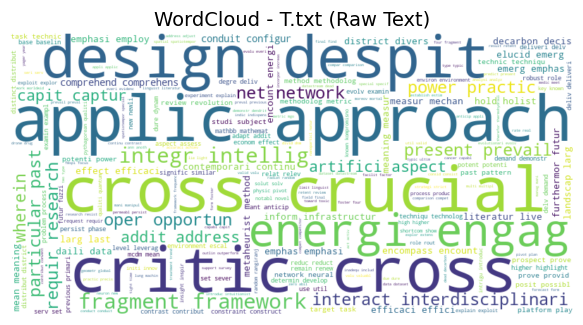

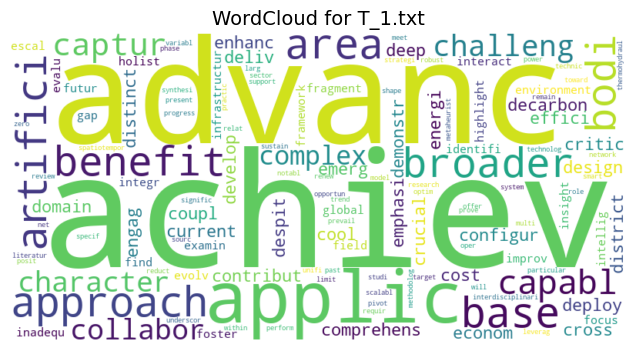

✅ Saved WordCloud image: WordClouds/T_\T_1.png


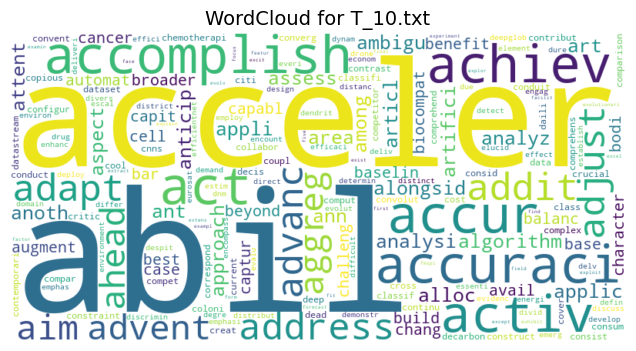

✅ Saved WordCloud image: WordClouds/T_\T_10.png


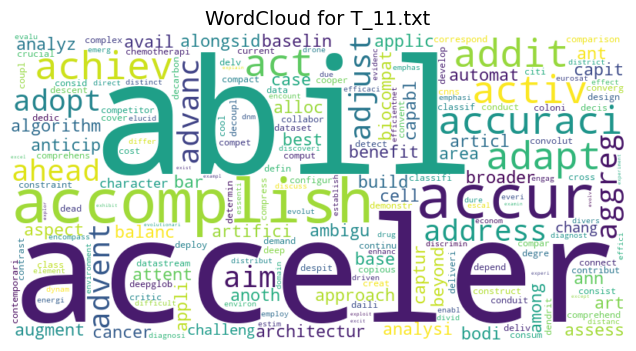

✅ Saved WordCloud image: WordClouds/T_\T_11.png


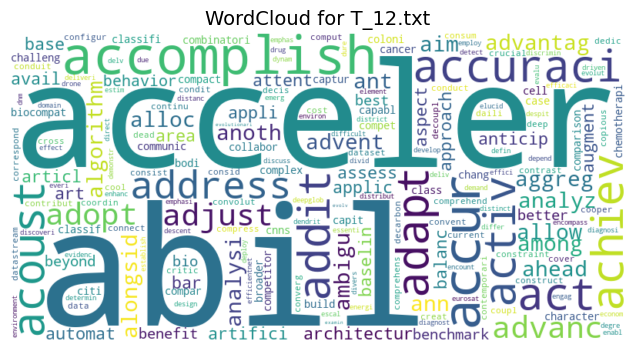

✅ Saved WordCloud image: WordClouds/T_\T_12.png


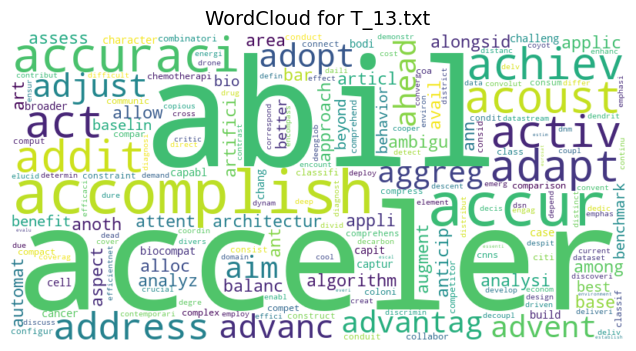

✅ Saved WordCloud image: WordClouds/T_\T_13.png


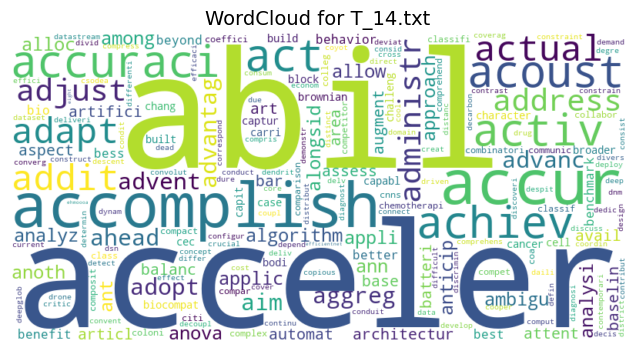

✅ Saved WordCloud image: WordClouds/T_\T_14.png


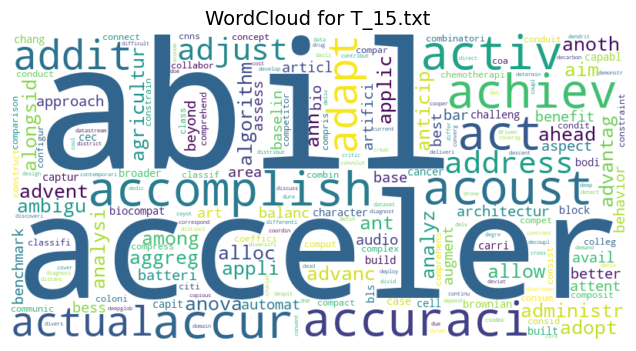

✅ Saved WordCloud image: WordClouds/T_\T_15.png


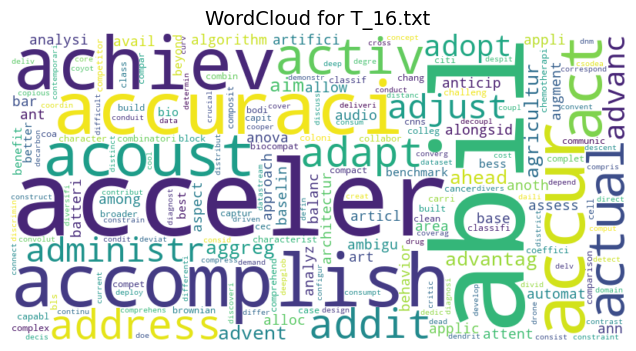

✅ Saved WordCloud image: WordClouds/T_\T_16.png


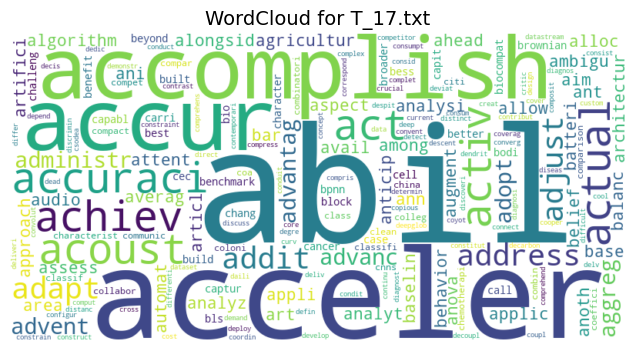

✅ Saved WordCloud image: WordClouds/T_\T_17.png


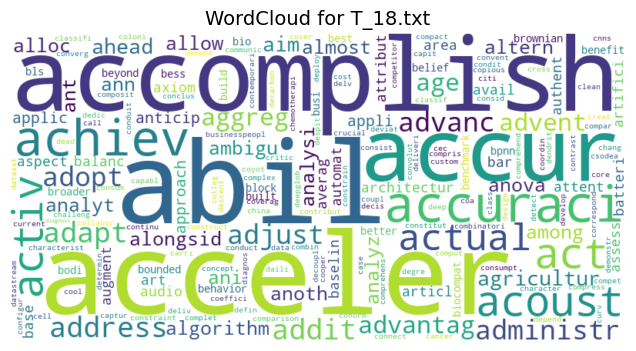

✅ Saved WordCloud image: WordClouds/T_\T_18.png


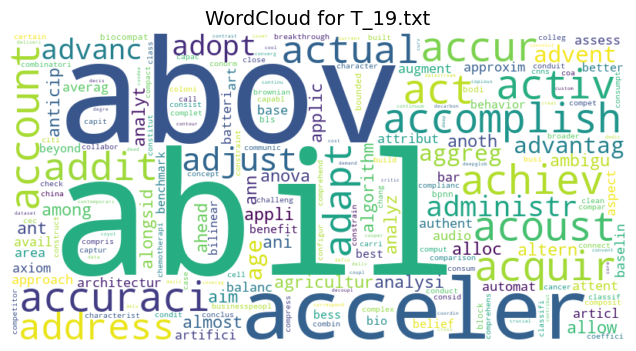

✅ Saved WordCloud image: WordClouds/T_\T_19.png


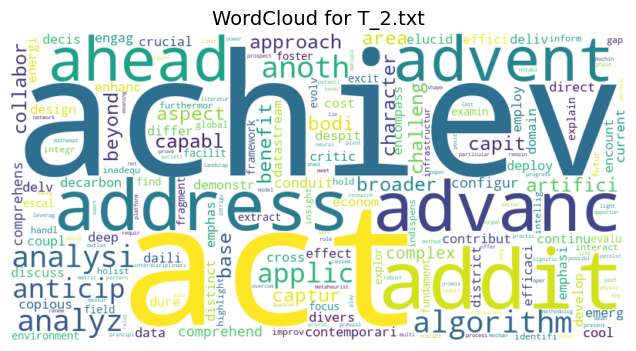

✅ Saved WordCloud image: WordClouds/T_\T_2.png


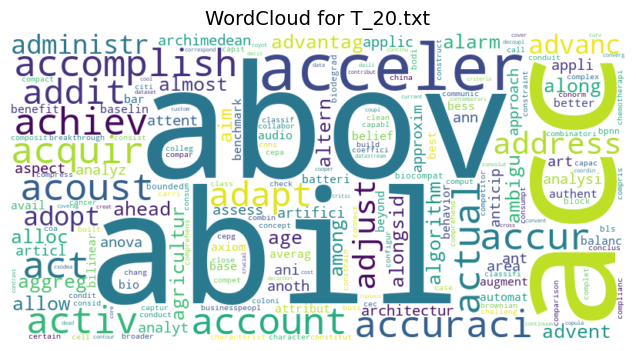

✅ Saved WordCloud image: WordClouds/T_\T_20.png


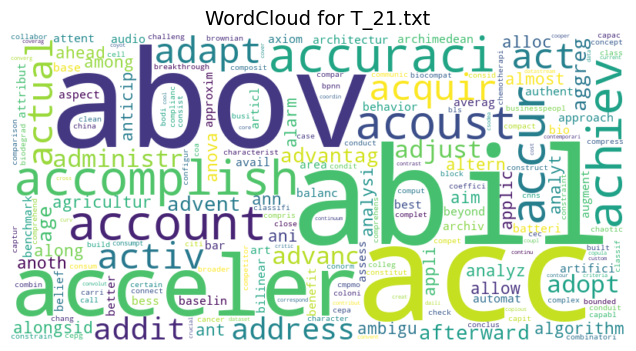

✅ Saved WordCloud image: WordClouds/T_\T_21.png


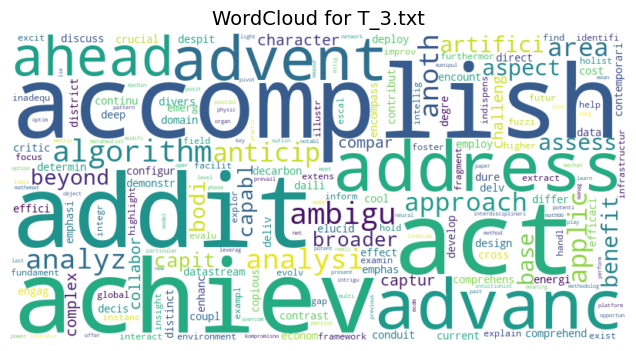

✅ Saved WordCloud image: WordClouds/T_\T_3.png


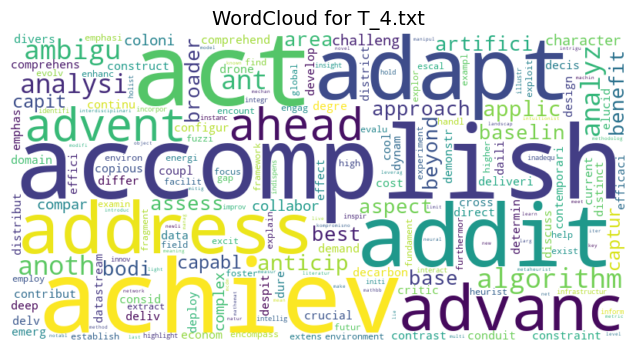

✅ Saved WordCloud image: WordClouds/T_\T_4.png


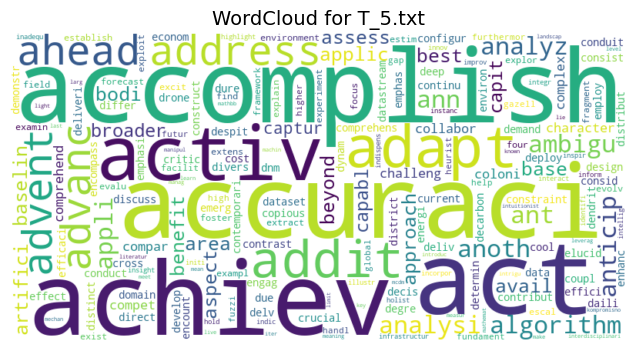

✅ Saved WordCloud image: WordClouds/T_\T_5.png


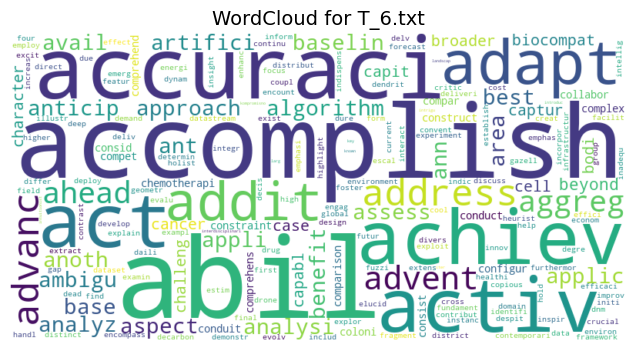

✅ Saved WordCloud image: WordClouds/T_\T_6.png


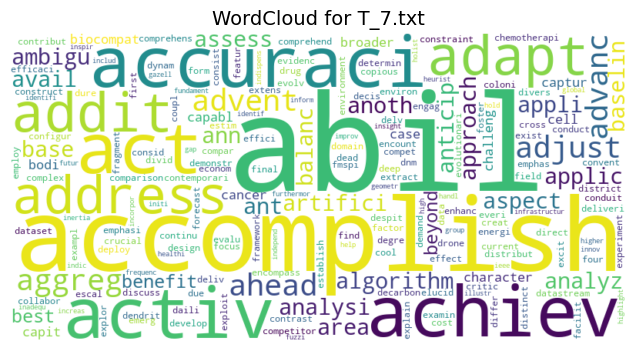

✅ Saved WordCloud image: WordClouds/T_\T_7.png


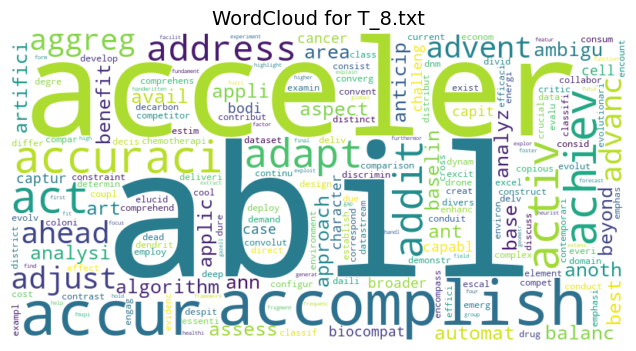

✅ Saved WordCloud image: WordClouds/T_\T_8.png


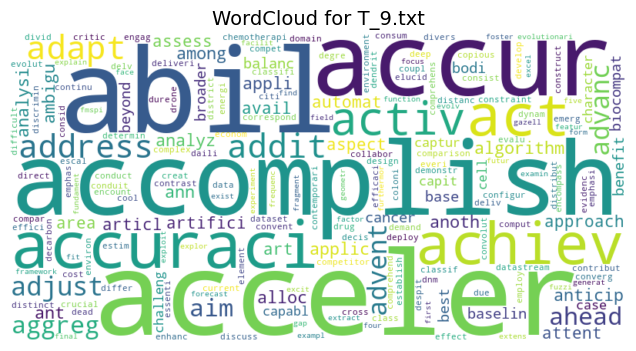

✅ Saved WordCloud image: WordClouds/T_\T_9.png


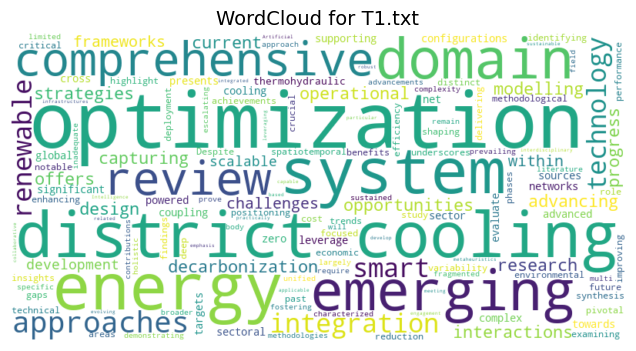

✅ Saved WordCloud image: WordClouds/T\T1.png


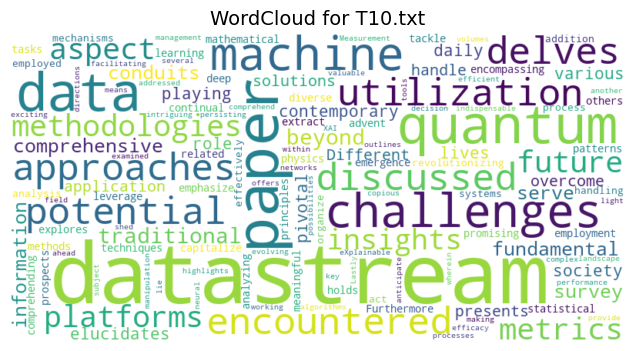

✅ Saved WordCloud image: WordClouds/T\T10.png


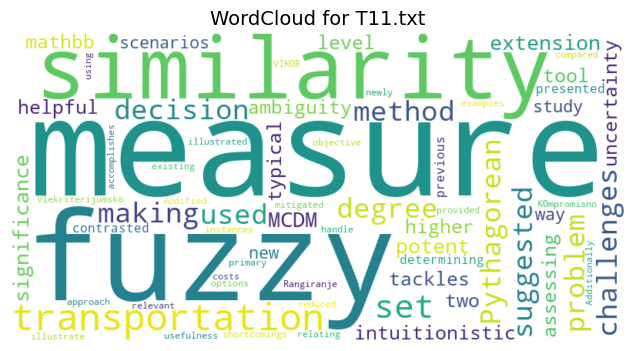

✅ Saved WordCloud image: WordClouds/T\T11.png


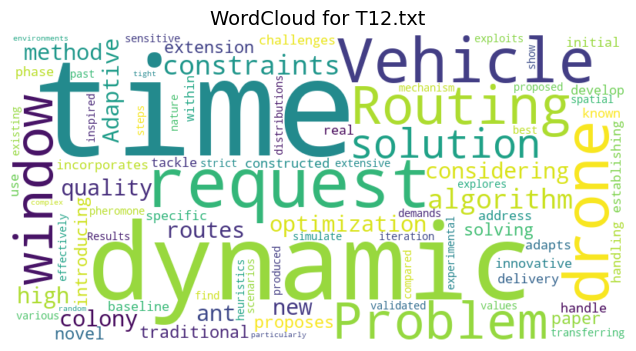

✅ Saved WordCloud image: WordClouds/T\T12.png


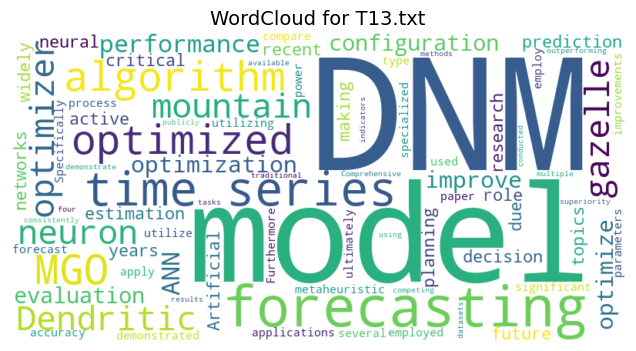

✅ Saved WordCloud image: WordClouds/T\T13.png


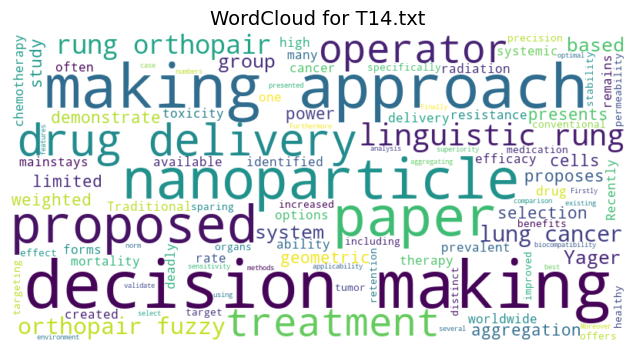

✅ Saved WordCloud image: WordClouds/T\T14.png


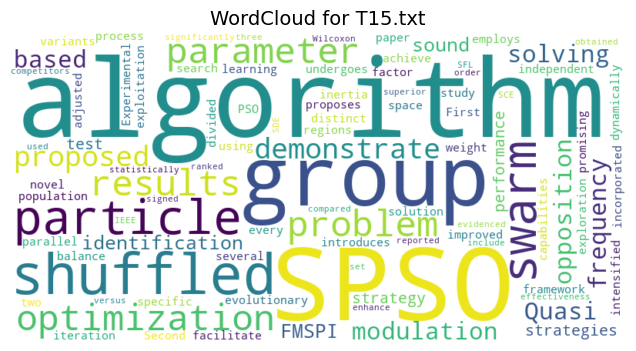

✅ Saved WordCloud image: WordClouds/T\T15.png


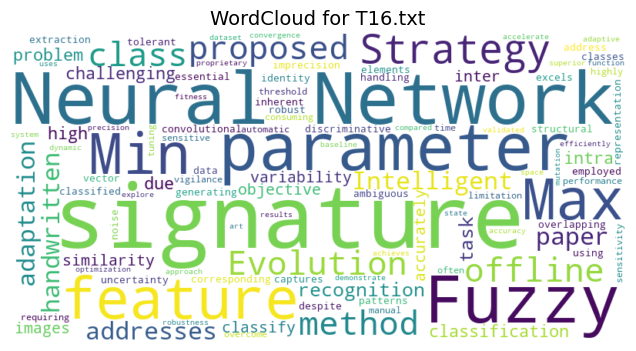

✅ Saved WordCloud image: WordClouds/T\T16.png


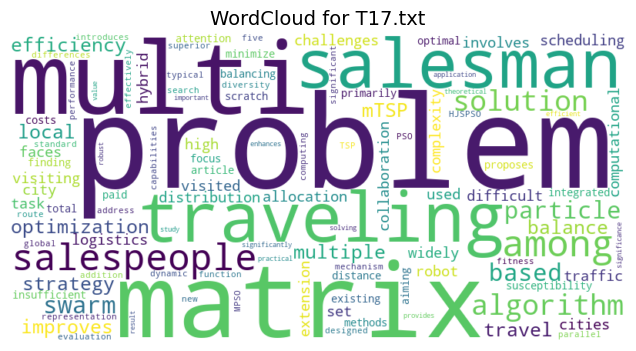

✅ Saved WordCloud image: WordClouds/T\T17.png


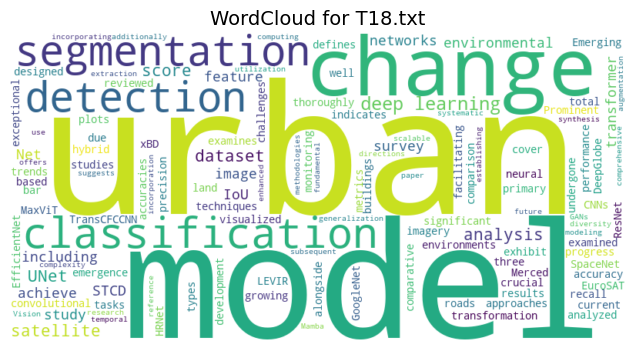

✅ Saved WordCloud image: WordClouds/T\T18.png


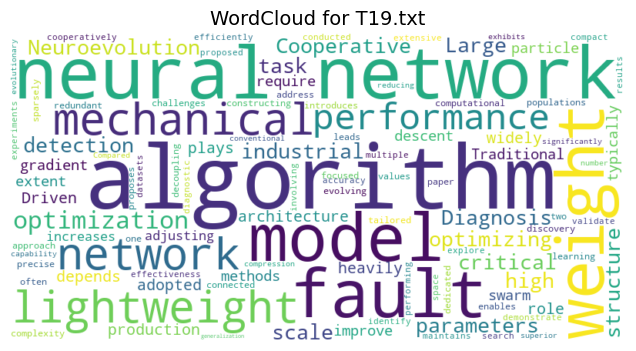

✅ Saved WordCloud image: WordClouds/T\T19.png


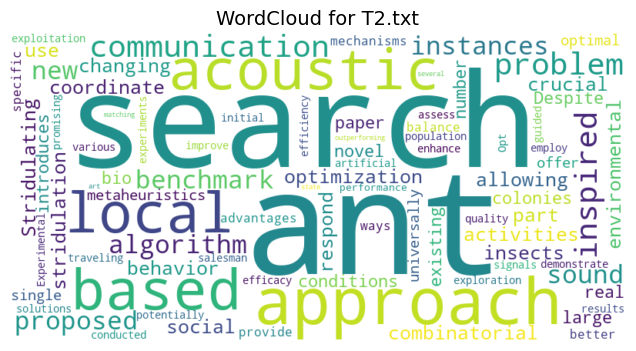

✅ Saved WordCloud image: WordClouds/T\T2.png


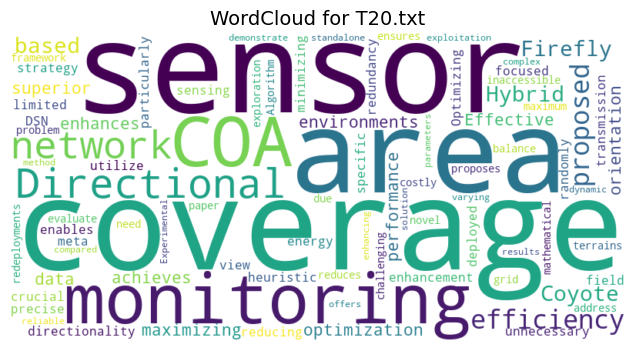

✅ Saved WordCloud image: WordClouds/T\T20.png


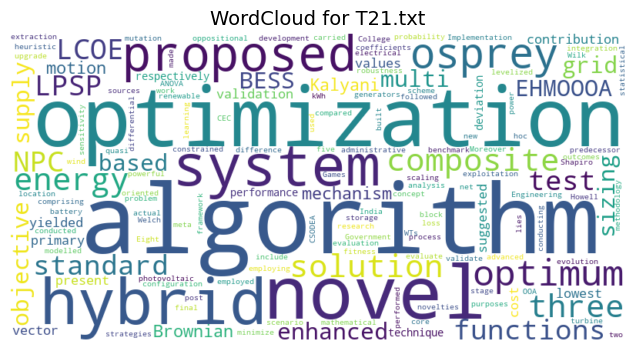

✅ Saved WordCloud image: WordClouds/T\T21.png


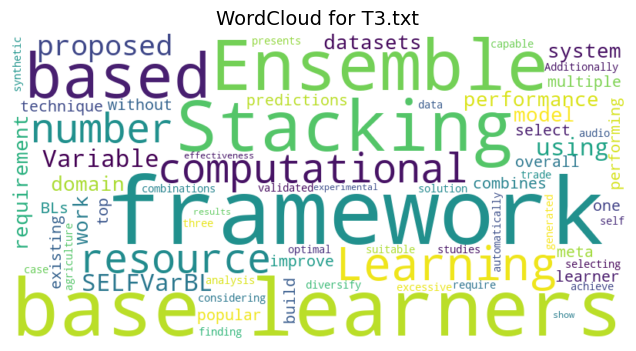

✅ Saved WordCloud image: WordClouds/T\T3.png


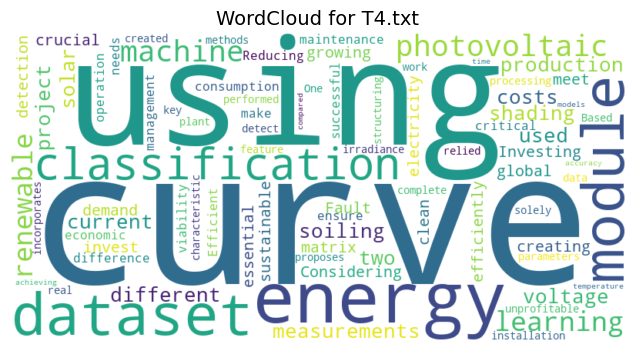

✅ Saved WordCloud image: WordClouds/T\T4.png


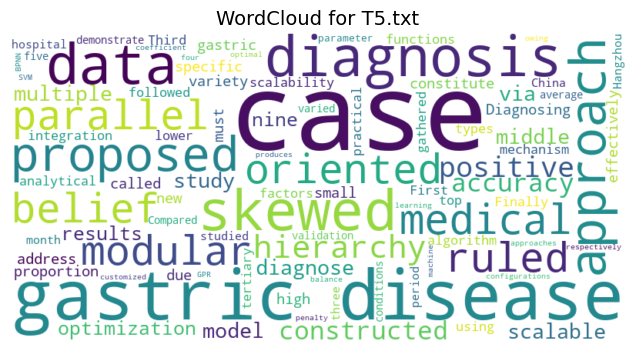

✅ Saved WordCloud image: WordClouds/T\T5.png


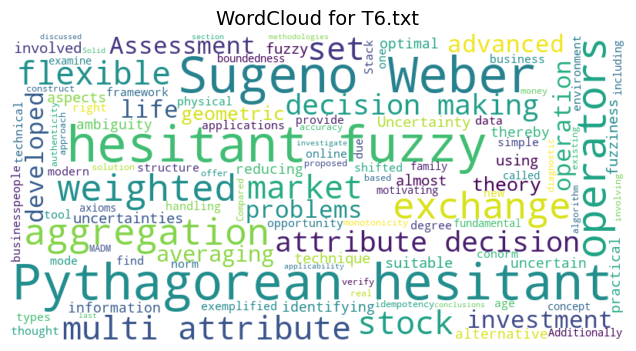

✅ Saved WordCloud image: WordClouds/T\T6.png


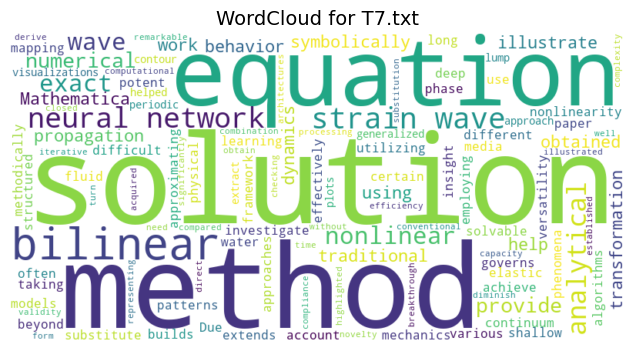

✅ Saved WordCloud image: WordClouds/T\T7.png


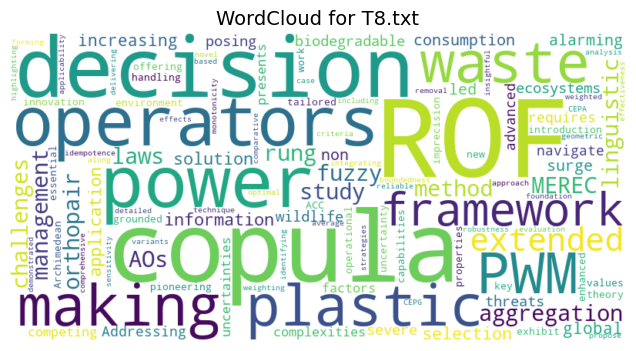

✅ Saved WordCloud image: WordClouds/T\T8.png


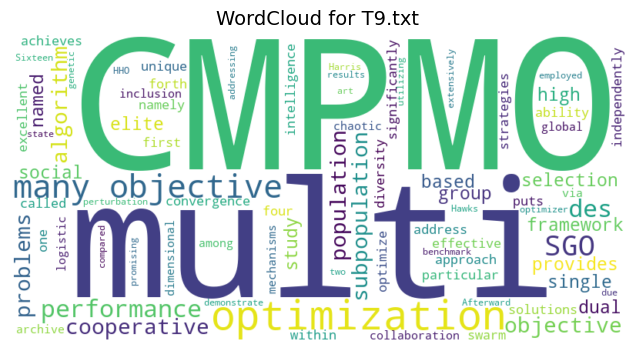

✅ Saved WordCloud image: WordClouds/T\T9.png


In [14]:
import glob
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import os

def read_file(filepath):
    with open(filepath, 'r', encoding='utf-8') as f:
        return f.read()

def visualize_wordclouds():
    """
    Generate and display WordClouds for each T_N file (T_N1.txt, T_N2.txt, ...).
    """
    # Create output folder for saving WordCloud images (optional)
    os.makedirs('WordClouds', exist_ok=True)
    os.makedirs('WordClouds/T_', exist_ok=True)
    os.makedirs('WordClouds/T', exist_ok=True)

    # Read 
    text_raw = read_file('T.txt')

    # Create WordCloud objects
    wc_raw = WordCloud(width=800, height=400, background_color='white').generate(text_raw)

    # Display side by side
    plt.figure(figsize=(16, 8))

    plt.subplot(1, 2, 1)
    plt.imshow(wc_raw, interpolation='bilinear')
    plt.axis('off')
    plt.title('WordCloud - T.txt (Raw Text)', fontsize=14)

    save_path = os.path.join('WordClouds', os.path.basename('T.txt').replace('.txt', '.png'))
    wc_raw.to_file(save_path)
    print(f"✅ Saved WordCloud image: {save_path}")

    # Get all T_N files sorted
    files = sorted(glob.glob('T_/*.txt'))

    for file_path in files:
        with open(file_path, 'r', encoding='utf-8') as f:
            text = f.read()

        # Generate word cloud
        wc = WordCloud(width=800, height=400, background_color='white').generate(text)

        # Display WordCloud
        plt.figure(figsize=(8, 4))
        plt.imshow(wc, interpolation='bilinear')
        plt.axis('off')
        plt.title(f"WordCloud for {os.path.basename(file_path)}", fontsize=14)
        plt.show()

        # Save as image (optional)
        save_path = os.path.join('WordClouds/T_', os.path.basename(file_path).replace('.txt', '.png'))
        wc.to_file(save_path)
        print(f"✅ Saved WordCloud image: {save_path}")
    

    # Get all T_N files sorted
    files = sorted(glob.glob('T/*.txt'))

    for file_path in files:
        with open(file_path, 'r', encoding='utf-8') as f:
            text = f.read()

        # Generate word cloud
        wc = WordCloud(width=800, height=400, background_color='white').generate(text)

        # Display WordCloud
        plt.figure(figsize=(8, 4))
        plt.imshow(wc, interpolation='bilinear')
        plt.axis('off')
        plt.title(f"WordCloud for {os.path.basename(file_path)}", fontsize=14)
        plt.show()

        # Save as image (optional)
        save_path = os.path.join('WordClouds/T', os.path.basename(file_path).replace('.txt', '.png'))
        wc.to_file(save_path)
        print(f"✅ Saved WordCloud image: {save_path}")

if __name__ == '__main__':
    visualize_wordclouds()


after removing stop words

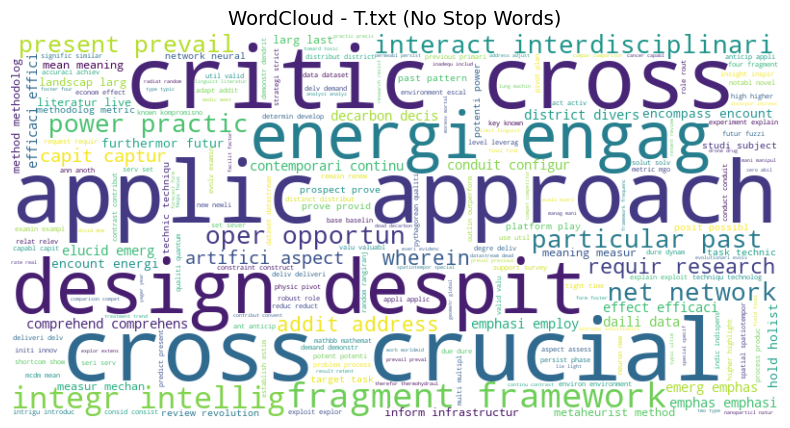

✅ Saved WordCloud image: WordClouds_NoStopWords\T.png


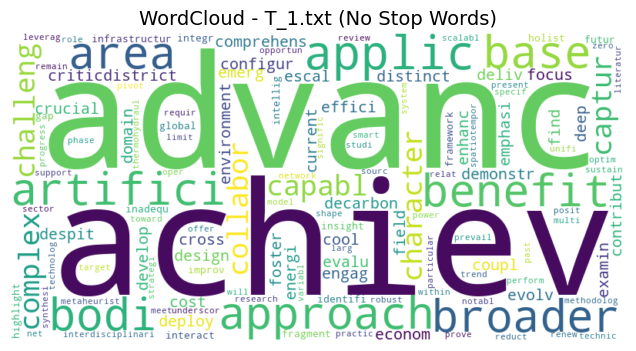

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_1.png


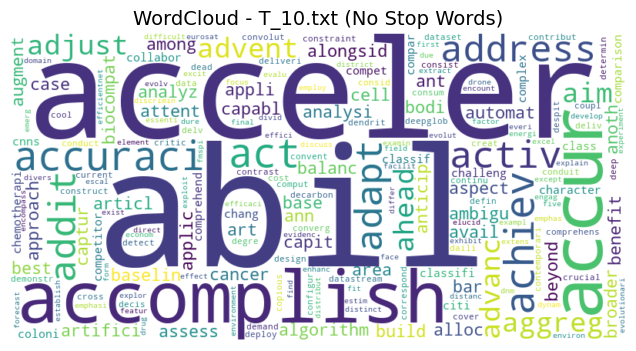

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_10.png


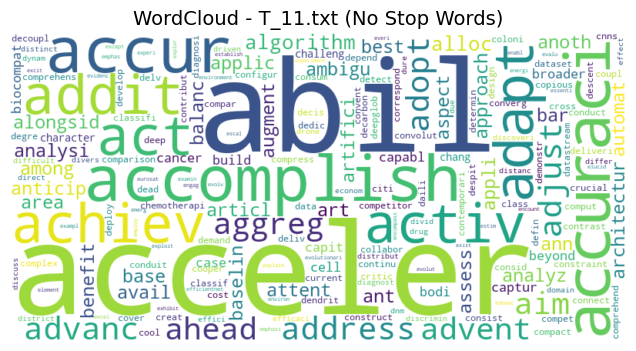

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_11.png


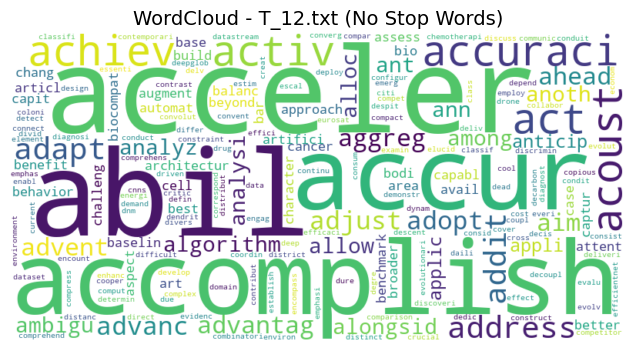

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_12.png


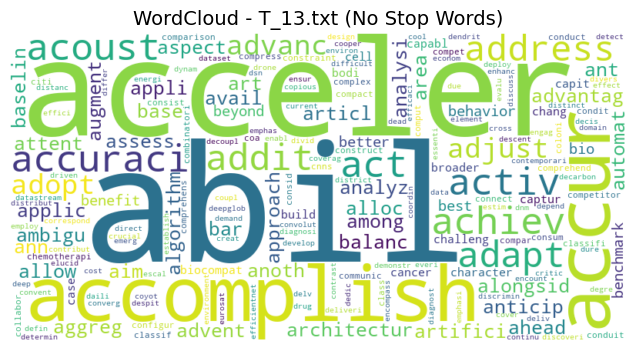

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_13.png


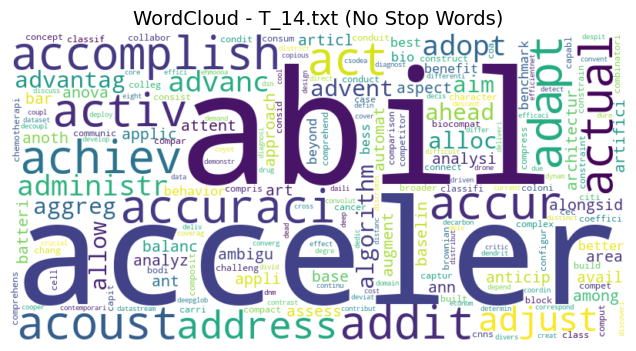

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_14.png


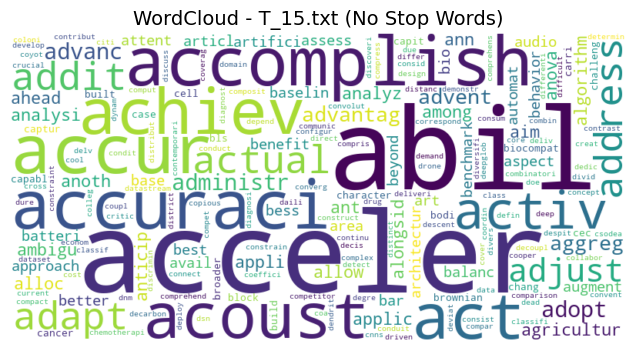

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_15.png


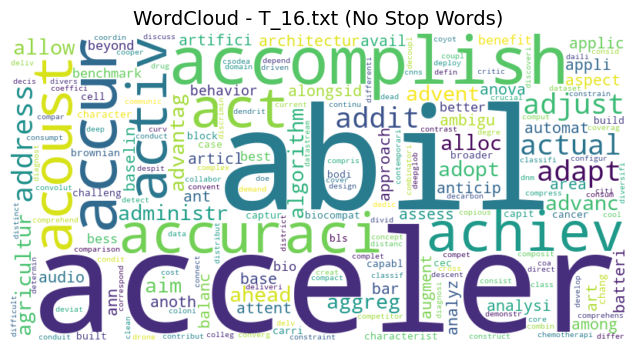

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_16.png


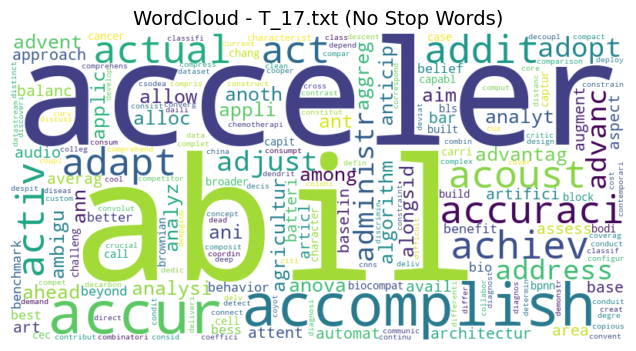

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_17.png


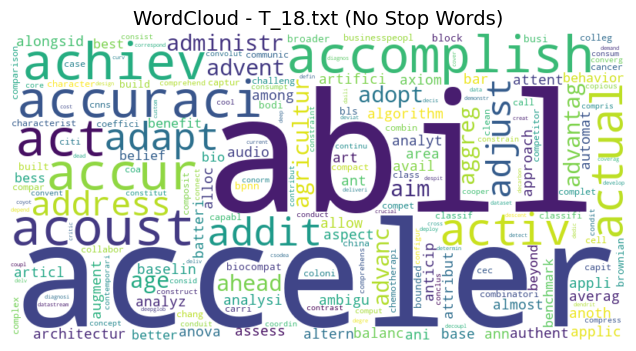

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_18.png


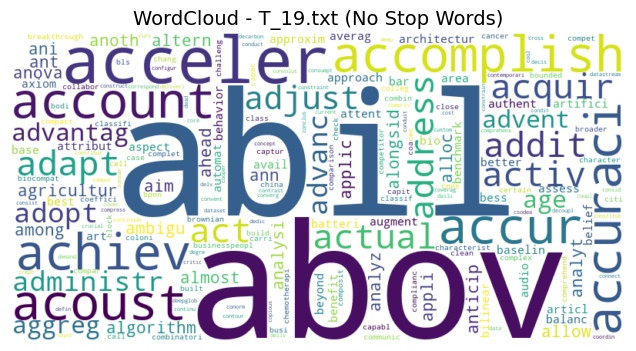

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_19.png


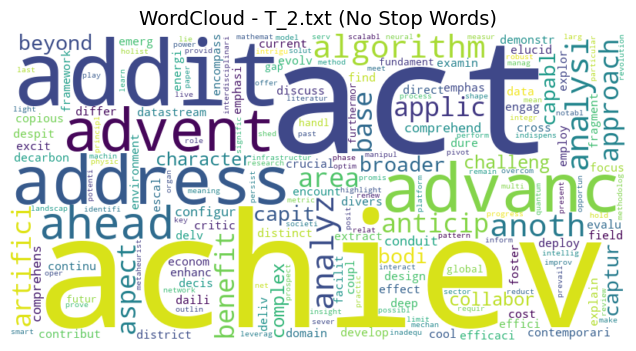

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_2.png


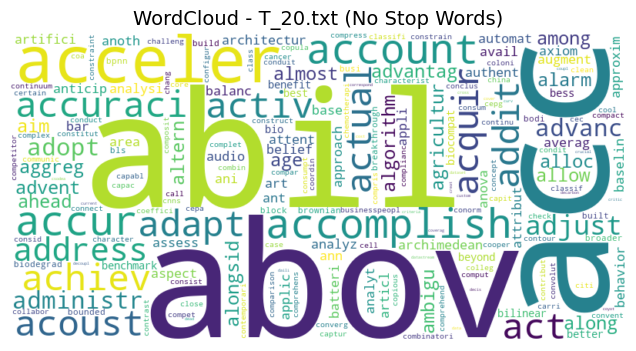

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_20.png


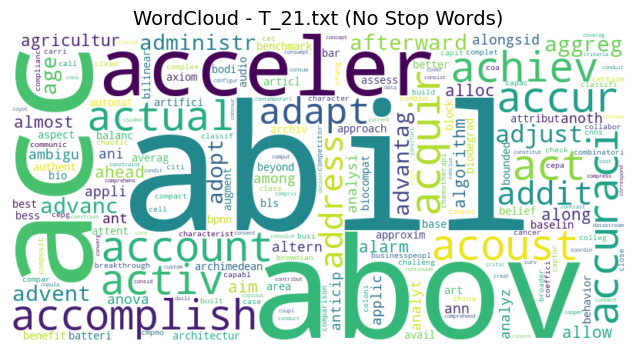

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_21.png


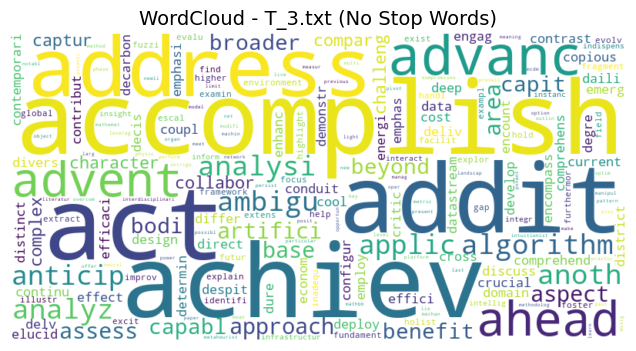

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_3.png


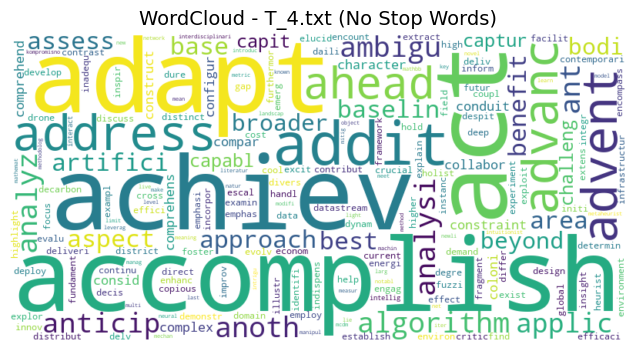

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_4.png


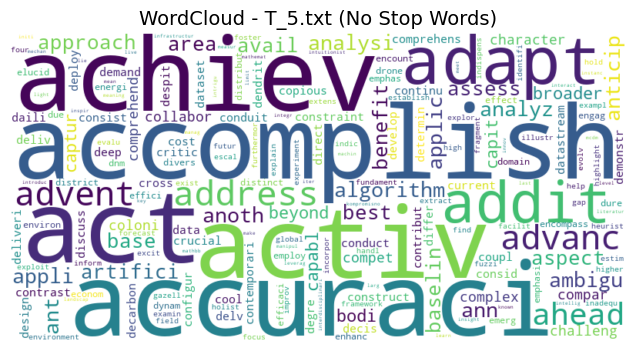

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_5.png


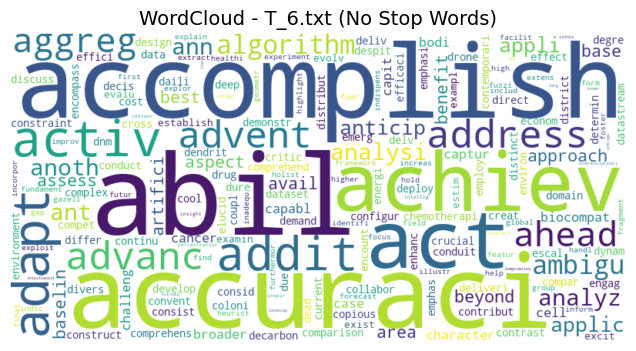

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_6.png


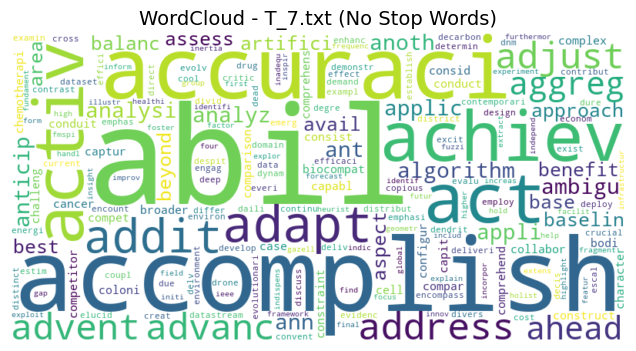

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_7.png


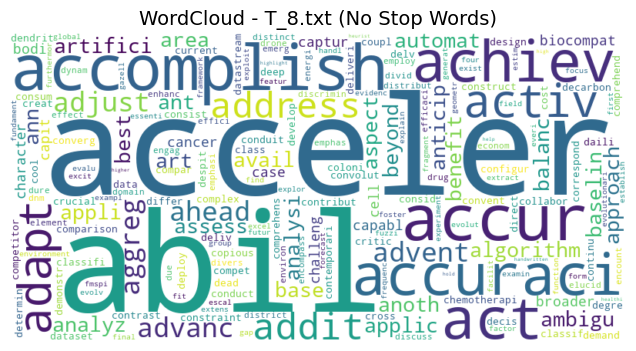

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_8.png


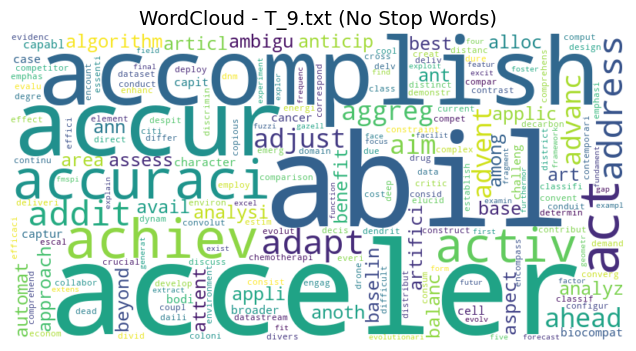

✅ Saved WordCloud image: WordClouds_NoStopWords/T_\T_9.png


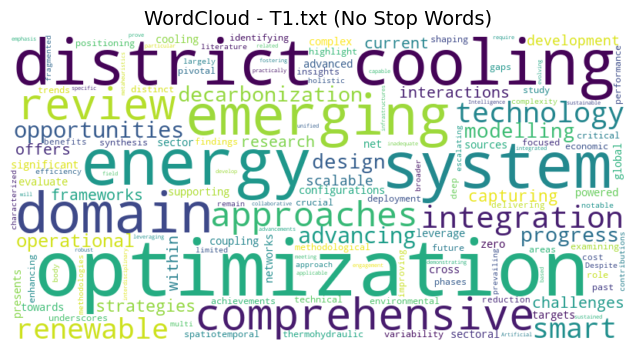

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T1.png


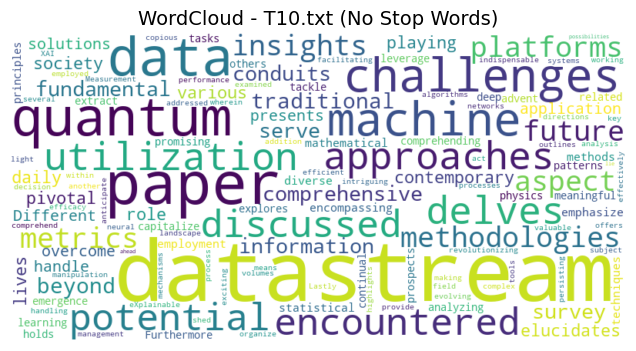

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T10.png


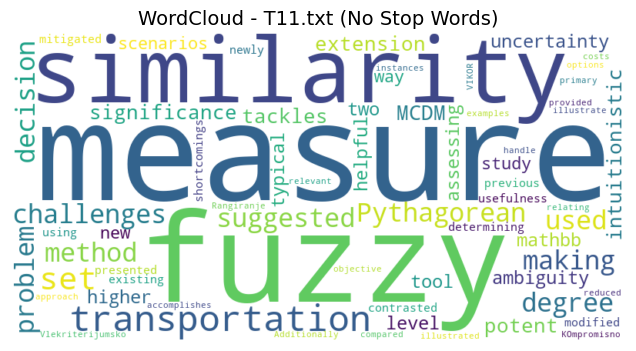

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T11.png


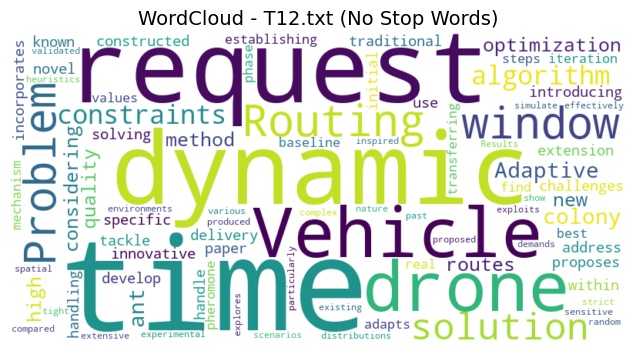

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T12.png


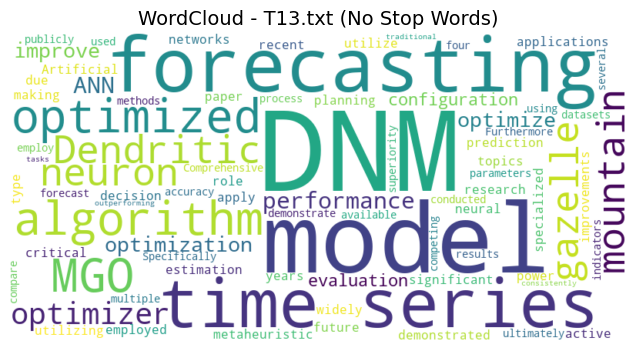

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T13.png


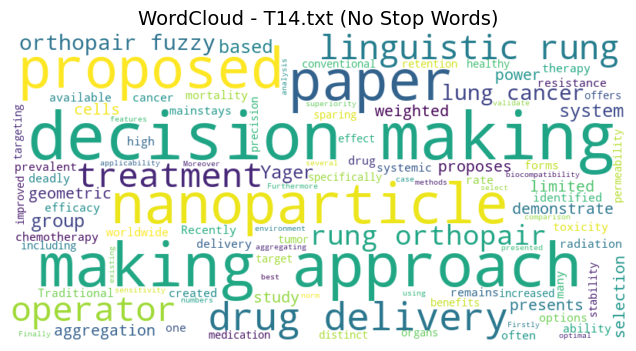

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T14.png


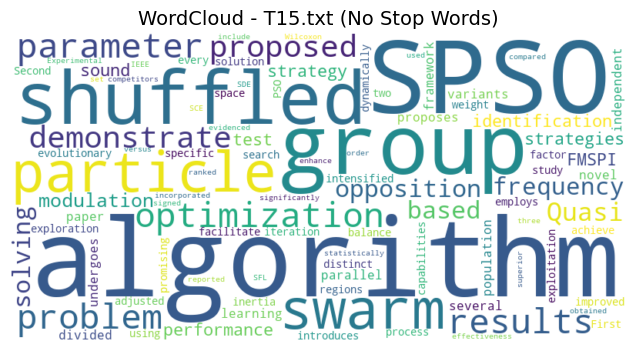

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T15.png


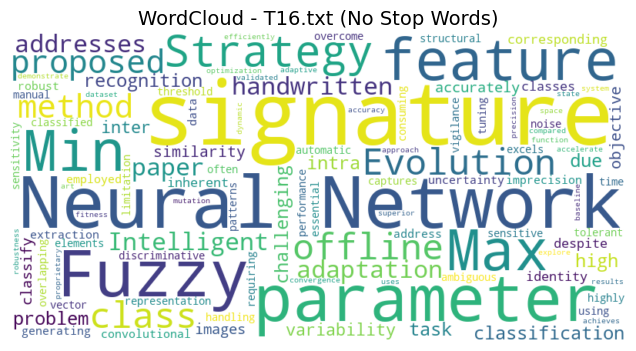

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T16.png


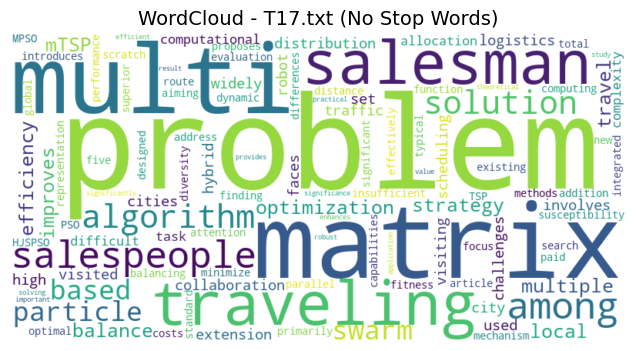

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T17.png


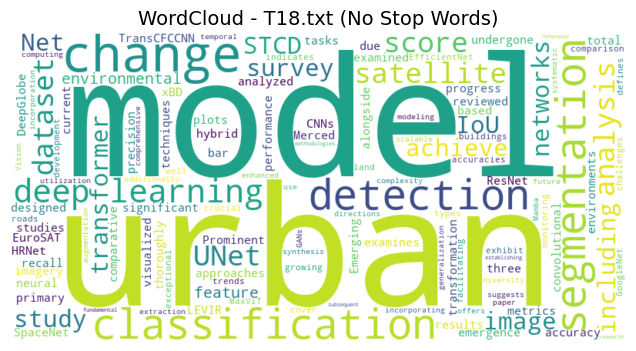

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T18.png


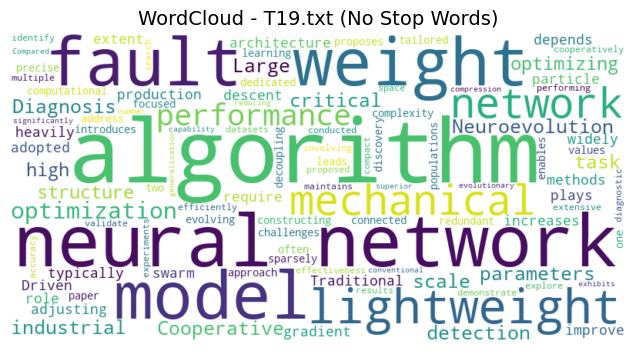

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T19.png


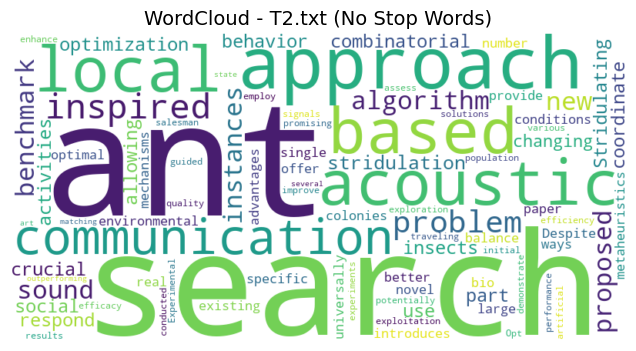

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T2.png


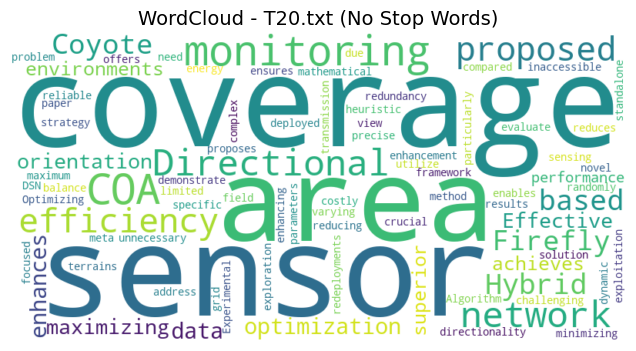

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T20.png


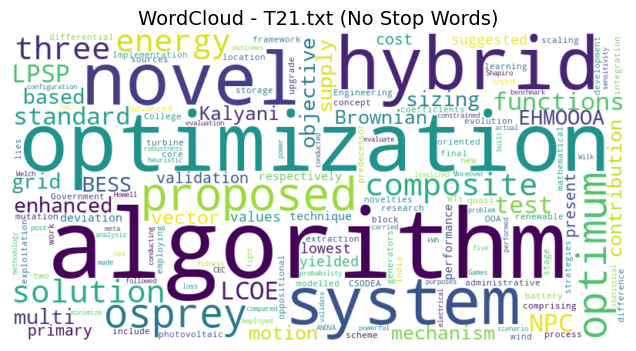

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T21.png


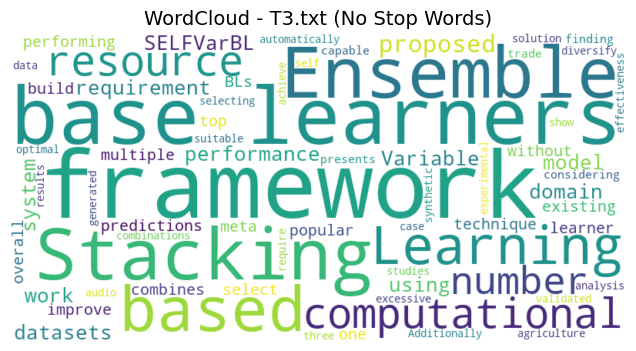

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T3.png


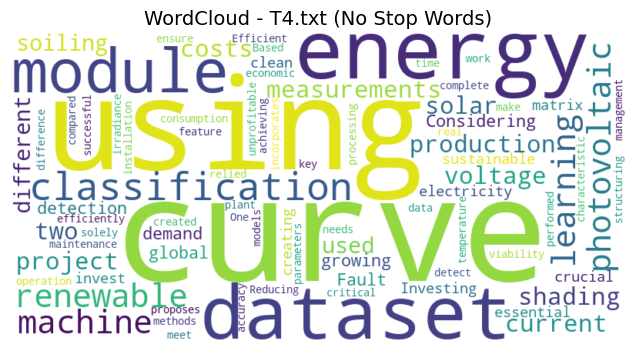

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T4.png


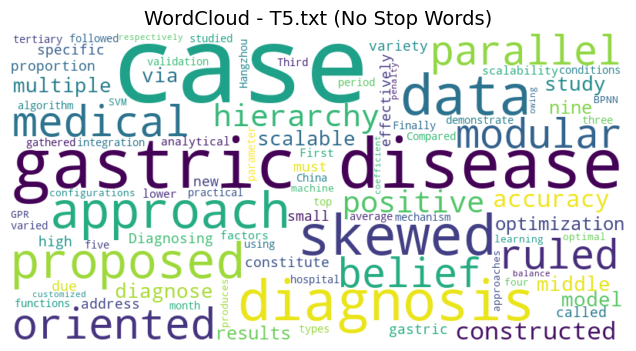

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T5.png


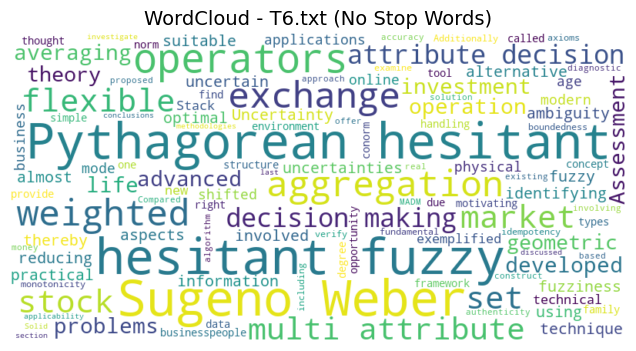

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T6.png


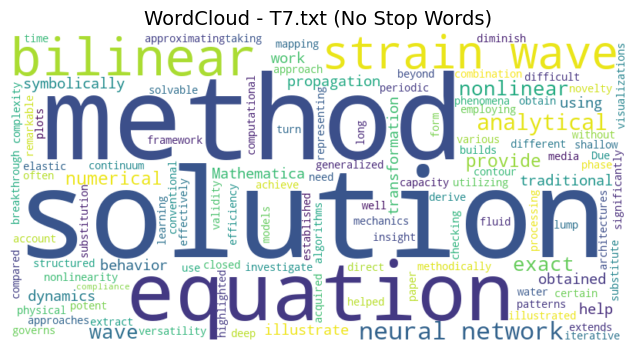

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T7.png


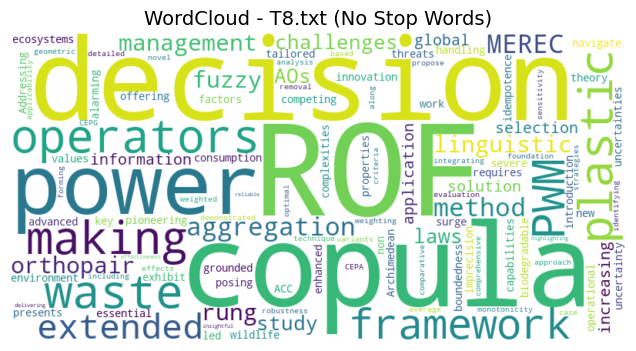

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T8.png


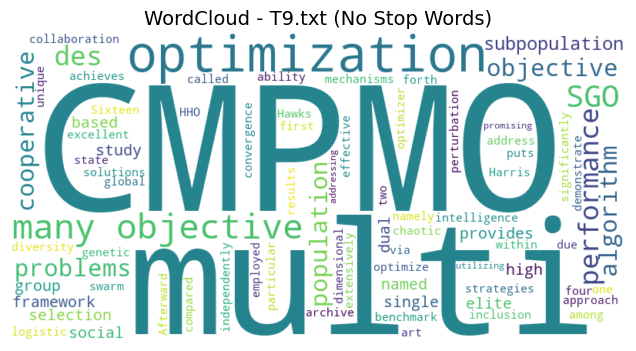

✅ Saved WordCloud image: WordClouds_NoStopWords/T\T9.png


In [16]:
import glob
import matplotlib.pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import os

def read_file(filepath):
    with open(filepath, 'r', encoding='utf-8') as f:
        return f.read()

def visualize_wordclouds():
    """
    Generate and display WordClouds for T.txt, T/*.txt, and T_/*.txt
    (with stop words removed).
    """
    # Define stopwords (extend default set)
    custom_stopwords = STOPWORDS.union({'the', 'and', 'of', 'in', 'to', 'for', 'on', 'with', 'by', 'from', 
                                        'is', 'are', 'as', 'that', 'an', 'be', 'at', 'this', 'was', 'were'})

    # Create output folders
    os.makedirs('WordClouds_NoStopWords/T_', exist_ok=True)
    os.makedirs('WordClouds_NoStopWords/T', exist_ok=True)

    # --- T.txt ---
    text_raw = read_file('T.txt')
    wc_raw = WordCloud(width=800, height=400, background_color='white',
                       stopwords=custom_stopwords).generate(text_raw)

    plt.figure(figsize=(10, 5))
    plt.imshow(wc_raw, interpolation='bilinear')
    plt.axis('off')
    plt.title('WordCloud - T.txt (No Stop Words)', fontsize=14)
    plt.show()

    save_path = os.path.join('WordClouds_NoStopWords', 'T.png')
    wc_raw.to_file(save_path)
    print(f"✅ Saved WordCloud image: {save_path}")

    # --- T_/ folder (normalized tokens) ---
    for file_path in sorted(glob.glob('T_/*.txt')):
        text = read_file(file_path)
        wc = WordCloud(width=800, height=400, background_color='white',
                       stopwords=custom_stopwords).generate(text)

        plt.figure(figsize=(8, 4))
        plt.imshow(wc, interpolation='bilinear')
        plt.axis('off')
        plt.title(f"WordCloud - {os.path.basename(file_path)} (No Stop Words)", fontsize=14)
        plt.show()

        save_path = os.path.join('WordClouds_NoStopWords/T_', os.path.basename(file_path).replace('.txt', '.png'))
        wc.to_file(save_path)
        print(f"✅ Saved WordCloud image: {save_path}")

    # --- T/ folder (raw tokens) ---
    for file_path in sorted(glob.glob('T/*.txt')):
        text = read_file(file_path)
        wc = WordCloud(width=800, height=400, background_color='white',
                       stopwords=custom_stopwords).generate(text)

        plt.figure(figsize=(8, 4))
        plt.imshow(wc, interpolation='bilinear')
        plt.axis('off')
        plt.title(f"WordCloud - {os.path.basename(file_path)} (No Stop Words)", fontsize=14)
        plt.show()

        save_path = os.path.join('WordClouds_NoStopWords/T', os.path.basename(file_path).replace('.txt', '.png'))
        wc.to_file(save_path)
        print(f"✅ Saved WordCloud image: {save_path}")

if __name__ == '__main__':
    visualize_wordclouds()


## Edit Distance
Implement the algorithm that computes the minimum edit distance (or Levenshtein distance) between two strings, as covered in class.

The edit distance between two strings is the minimum number of single-character operations needed to transform one string into another:

Insertion

Deletion

Substitution

Each operation typically costs 1.

Meaning:

dp[i][0] = cost to convert s1[0..i] → "" (empty string)
→ You need i deletions.

dp[0][j] = cost to convert "" → s2[0..j]
→ You need j insertions.

|    | "" | s | i | t | t | i | n | g |
| -- | -- | - | - | - | - | - | - | - |
| "" | 0  | 1 | 2 | 3 | 4 | 5 | 6 | 7 |
| k  | 1  |   |   |   |   |   |   |   |
| i  | 2  |   |   |   |   |   |   |   |
| t  | 3  |   |   |   |   |   |   |   |
| t  | 4  |   |   |   |   |   |   |   |
| e  | 5  |   |   |   |   |   |   |   |
| n  | 6  |   |   |   |   |   |   |   |


🧩 Meaning of each operation:

At position (i, j), we compare s1[i-1] and s2[j-1].

1️⃣ Deletion

If we delete the last char of s1[0..i],
the remaining part is s1[0..i-1] → s2[0..j],
so the cost is:

dp[i-1][j] + 1

2️⃣ Insertion

If we insert a character into s1 to match s2[j-1],
we now need to transform s1[0..i] → s2[0..j-1],
so:

dp[i][j-1] + 1

3️⃣ Substitution

If we replace s1[i-1] by s2[j-1],
then we only need to compute the cost for previous substrings:

dp[i-1][j-1] + cost
(where cost = 0 if the characters are equal, otherwise 1)

Let’s fill the first few cells for "kitten" vs "sitting":
|    | "" | s | i | t | t | i | n | g |
| -- | -- | - | - | - | - | - | - | - |
| "" | 0  | 1 | 2 | 3 | 4 | 5 | 6 | 7 |
| k  | 1  | 1 | 2 | 3 | 4 | 5 | 6 | 7 |
| i  | 2  | 2 | 1 | 2 | 3 | 4 | 5 | 6 |
| t  | 3  | 3 | 2 | 1 | 2 | 3 | 4 | 5 |
| t  | 4  | 4 | 3 | 2 | 1 | 2 | 3 | 4 |
| e  | 5  | 5 | 4 | 3 | 2 | 2 | 3 | 4 |
| n  | 6  | 6 | 5 | 4 | 3 | 3 | 2 | 3 |

dp[i][j] = minimum edits to turn first i chars of s1 into first j chars of s2.

Step 1: Remember what dp[i-1][j-1] means

dp[i-1][j-1] = dp[0,1] = 1

This represents the minimum edits to turn the first 0 letters of s1 ("") into the first 1 letter of s2 ("s").

To go from "" → "s", we need 1 insertion. ✅
cost = 1 if current letters are different (s1[0] = "k" vs s2[1] = "i")

So dp[1,2] = dp[0,1] + 1 = 1 + 1 = 2

In [4]:
def read_file(filepath):
    with open(filepath, 'r', encoding='utf-8') as f:
        return f.read() 
    
def levenshtein_distance(s1, s2):
    """
    Compute the minimum edit distance (Levenshtein distance)
    between two strings s1 and s2.
    """
    m, n = len(s1), len(s2)

    # Create distance matrix of size (m+1) x (n+1)
    dp = [[0] * (n + 1) for _ in range(m + 1)]

    # Initialize base cases
    for i in range(m + 1):
        dp[i][0] = i  # cost of deleting all characters from s1
    for j in range(n + 1):
        dp[0][j] = j  # cost of inserting all characters into s1

    # Fill DP matrix
    for i in range(1, m + 1):
        for j in range(1, n + 1):
            cost = 0 if s1[i - 1] == s2[j - 1] else 1

            dp[i][j] = min(
                dp[i - 1][j] + 1,      # deletion
                dp[i][j - 1] + 1,      # insertion
                dp[i - 1][j - 1] + cost  # substitution
            )

            # display matrix
            for row in dp:
                print(row)
            print()  # blank line between steps

    return dp[m][n]

if __name__ == '__main__':
  # taking 2 random strings from S.txt
#   content = read_file('S.txt')
#   s1, s2 = content.splitlines()[:2]  # first two lines 
  s1 = "kitten"
  s2 = "sitting"
  dist = levenshtein_distance(s1, s2)
  print(f"Minimum edit distance between '{s1}' and '{s2}' is {dist}")


[0, 1, 2, 3, 4, 5, 6, 7]
[1, 1, 0, 0, 0, 0, 0, 0]
[2, 0, 0, 0, 0, 0, 0, 0]
[3, 0, 0, 0, 0, 0, 0, 0]
[4, 0, 0, 0, 0, 0, 0, 0]
[5, 0, 0, 0, 0, 0, 0, 0]
[6, 0, 0, 0, 0, 0, 0, 0]

[0, 1, 2, 3, 4, 5, 6, 7]
[1, 1, 2, 0, 0, 0, 0, 0]
[2, 0, 0, 0, 0, 0, 0, 0]
[3, 0, 0, 0, 0, 0, 0, 0]
[4, 0, 0, 0, 0, 0, 0, 0]
[5, 0, 0, 0, 0, 0, 0, 0]
[6, 0, 0, 0, 0, 0, 0, 0]

[0, 1, 2, 3, 4, 5, 6, 7]
[1, 1, 2, 3, 0, 0, 0, 0]
[2, 0, 0, 0, 0, 0, 0, 0]
[3, 0, 0, 0, 0, 0, 0, 0]
[4, 0, 0, 0, 0, 0, 0, 0]
[5, 0, 0, 0, 0, 0, 0, 0]
[6, 0, 0, 0, 0, 0, 0, 0]

[0, 1, 2, 3, 4, 5, 6, 7]
[1, 1, 2, 3, 4, 0, 0, 0]
[2, 0, 0, 0, 0, 0, 0, 0]
[3, 0, 0, 0, 0, 0, 0, 0]
[4, 0, 0, 0, 0, 0, 0, 0]
[5, 0, 0, 0, 0, 0, 0, 0]
[6, 0, 0, 0, 0, 0, 0, 0]

[0, 1, 2, 3, 4, 5, 6, 7]
[1, 1, 2, 3, 4, 5, 0, 0]
[2, 0, 0, 0, 0, 0, 0, 0]
[3, 0, 0, 0, 0, 0, 0, 0]
[4, 0, 0, 0, 0, 0, 0, 0]
[5, 0, 0, 0, 0, 0, 0, 0]
[6, 0, 0, 0, 0, 0, 0, 0]

[0, 1, 2, 3, 4, 5, 6, 7]
[1, 1, 2, 3, 4, 5, 6, 0]
[2, 0, 0, 0, 0, 0, 0, 0]
[3, 0, 0, 0, 0, 0, 0, 0]
[4, 0, 0, 0, 0, 0, 0